## Thunder Recap
The tutorials were very easy to follow. From someone who comes from a registration and image background, those tutorials were very nice. However, I also have very limited time series background and those tutorials were great as well, especially for beginners. All tutorials ran easily and in a timely manner on my computer. It was easily reproducible and easy to understand. 

Improvement:
- More MRI image sets as opposed to generic pictures or mnist. That would really help clinicians. One important thing that is needed right now is a direct pipe from raw dicom DTI to readable .nii on the computer ready to load into the Python workbook.

- Incorporate more of the preprocessing steps and possible pipeline usage (m2g) in tutorial. Needs to be more in depth on MRI in my opinion.

- Finally, could use a more zoomed out image of the time series data to show the familier eeg shape.


Three Things that worked well:

- Image indexing and filtering done very well. The filtering demonstrations done by the faculty at JHU in particular are very nicely done and easy to follow, even for someone who may not know Python.

- This leads into my next point, there is not a lot of Python lingo or hard to digest code, which is great!

- The strongest portion is the registration part in my opinion. It really breaks down well what registration is and how to do it for a beginner.

# Getting Data

First, we want to grab some graphs and subject covariates from a web-accessible url.  We've given this to you on github rather than having you set up aws s3 credentials or asking you to mount data in colab, in the interest of saving time. The original data is hosted at m2g.io

Below, you will be getting the following dataset:

| Property | Value |
|:--------:|:-----:|
| Dataset  | SWU4  |
| N-Subjects  | 454   |
| Scans-per-subjects | 2 |
| Atlases | Desikan, CPAC200 |
| Desikan Nodes | 70 |
| CPAC200 Nodes | 200 |

The covariates you have are: `SUBID, SESSION, AGE_AT_SCAN_1, SEX, RESTING_STATE_INSTRUCTION, TIME_OF_DAY, SEASON, SATIETY, LMP`. There are other columns in the `.csv` file (downloaded in the next step) but they are populated with a `#` meaning that the value was not recorded.

There are several other atlases available - you can change which one you use 
Running the cell below will get you the data. **Please note, you only have to run these two cells once!!!**

## Loading Graphs + Covariates
Run the following cells of code to load the graphs into your computer, as well as the covariates.

In [1]:
!pip install networkx==1.9 #networkx broke backwards compatibility with these graph files
import numpy as np
import networkx as nx
import scipy as sp
import matplotlib.pyplot as plt
import os
import csv


from collections import OrderedDict

In [2]:
## IF YOU FOLLOW THIS APPROACH, YOU'LL NEED TO TAKE ADDITONAL STEPS TO GET DATA ON YOUR DRIVE!!!
!git clone https://github.com/wrgr/graph-explorer.git

fatal: destination path 'graph-explorer' already exists and is not an empty directory.


In [3]:
!ls 'graph-explorer/SWU4'
ps = "graph-explorer/SWU4.csv"


CPAC200  desikan


In [4]:
# Initializing dataset names
dataset_names = 'SWU4'

basepath = 'graph-explorer'

# change which atlas you use, here!

atlas = 'desikan' # 'desikan' # or 'CPAC200', or 'Talairach'
dir_names = basepath + '/' + dataset_names + '/' + atlas
#basepath = "/"
#dir_names = basepath
print(dir_names)
fs = OrderedDict()
fs[dataset_names] = [root + "/" + fl for root, dirs, files in os.walk(dir_names)
                     for fl in files if fl.endswith(".gpickle")]



print("Datasets: " + ", ".join([fkey + " (" + str(len(fs[fkey])) + ")"
                                for fkey in fs]))
print("Total Subjects: %d" % (sum([len(fs[key]) for key in fs])))

graph-explorer/SWU4/desikan
Datasets: SWU4 (454)
Total Subjects: 454


In [0]:
def loadGraphs(filenames, verb=False):
    """
    Given a list of files, returns a dictionary of graphs

    Required parameters:
        filenames:
            - List of filenames for graphs
    Optional parameters:
        verb:
            - Toggles verbose output statements
    """
    #  Initializes empty dictionary
    gstruct = OrderedDict()
    for idx, files in enumerate(filenames):
        if verb:
            print("Loading: " + files)
        #  Adds graphs to dictionary with key being filename
        fname = os.path.basename(files)
        gstruct[fname] = nx.read_gpickle(files)
    return gstruct

def constructGraphDict(names, fs, verb=False):
    """
    Given a set of files and a directory to put things, loads graphs.

    Required parameters:
        names:
            - List of names of the datasets
        fs:
            - Dictionary of lists of files in each dataset
    Optional parameters:
        verb:
            - Toggles verbose output statements
    """
    #  Loads graphs into memory for all datasets
    graphs = OrderedDict()
    if verb:
        print("Loading Dataset: " + names)
    # The key for the dictionary of graphs is the dataset name
    graphs[names] = loadGraphs(fs[names], verb=verb)
    return graphs

In [0]:
graphs = constructGraphDict(dataset_names, fs, verb=False)

In [0]:
import csv
# This gets age and sex, respecitvely.
tmp = csv.reader(open(ps,newline='')) # this is the whole phenotype file
pheno = OrderedDict()
triple = [[t[0].strip(), t[2], int(t[3] == '2')] for t in tmp
          if t[3] != '#' and t[2] != '#'][1:]  # female=1->0, male=2->1

for idx, trip in enumerate(triple):
    pheno[trip[0]] = trip[1:]

In [0]:
## replace with this

k = sorted(list(graphs['SWU4'].keys()))
k_id = list(key[6:11] for key in k)
k_id_g1 = k_id[0::2]
k_id_g2 = k_id[1::2]
k_g1 = k[0::2]
k_g2 = k[1::2]

g1 = []
for xx in k_g1:
    g1.append(graphs['SWU4'][xx])

g2 = []
for xx in k_g2:
    g2.append(graphs['SWU4'][xx])

#Create vectors of labels
age_g1 = list()
sex_g1 = list()
age_g2 = list()
sex_g2 = list()
sex = list()
age = list()

for key in k_id_g1:
    sex_g1.append(pheno[key][1])
    age_g1.append(pheno[key][0])

for key in k_id_g2:
    sex_g2.append(pheno[key][1])
    age_g2.append(pheno[key][0])

for key in k_id:
  sex.append(pheno[key][1])
  age.append(pheno[key][0])

## ASSIGNMENT:  
(Code above used to get data in the correct format.  Below is a simple example test string with kind of silly features)

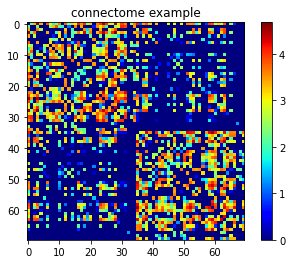

In [9]:
# plot a graph
import matplotlib.pyplot as plt
%matplotlib inline
i = 10
# convert to numpy
matrix = nx.to_numpy_matrix(g1[i], nodelist=sorted(g1[i].nodes())) #this is how you go to a matrix

plt.imshow(np.log10(matrix+1),cmap='jet')
plt.colorbar()
plt.title('connectome example')
plt.show()

Visualizing Mean Connectomes


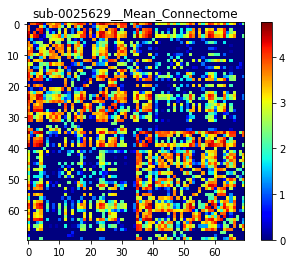

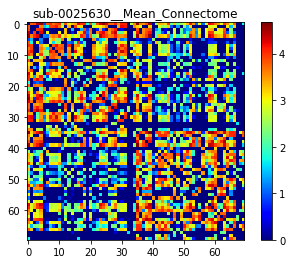

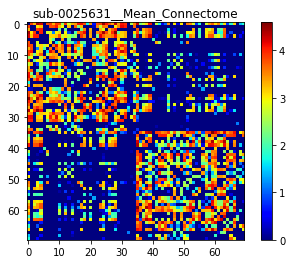

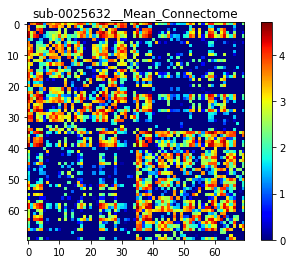

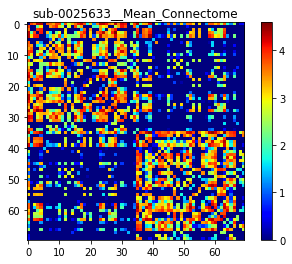

...

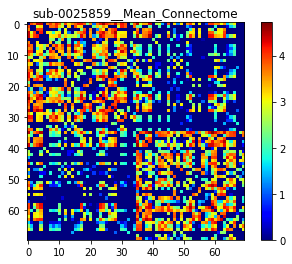

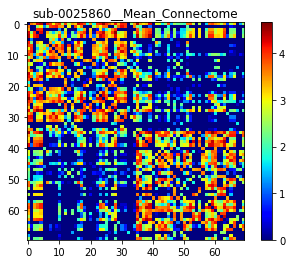

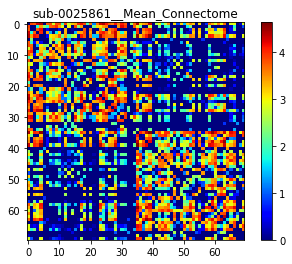

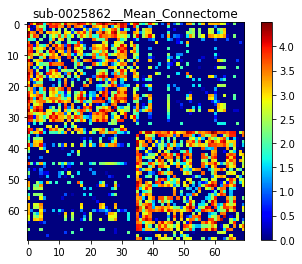

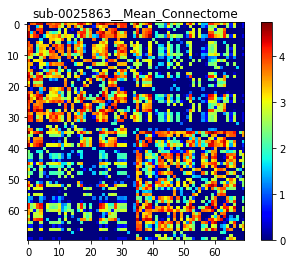

Visualizing Mean Connectome for All Session 1 Data


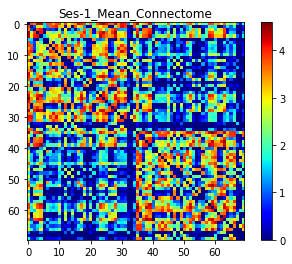

Visualizing Mean Connectome for All Session 2 Data


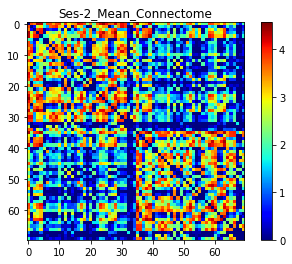

Visualizing Single Mean Connectome for All Data


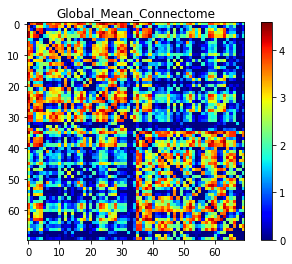

In [36]:
# Criteria 1 (25 points) compute and visualize mean connectomes for all of the data 

# Interpreted Question three ways: global mean, mean of g1 and g2 seperate, and
# mean of each subject by average ses-1 and ses-2.
mean_matrix_g1 = np.zeros((70,70))
mean_matrix_g2 = np.zeros((70,70))
global_mean_matrix = np.zeros((70,70))
print("Visualizing Mean Connectomes")
for i in range(len(g1)):
  matrix_g1 = nx.to_numpy_matrix(g1[i], nodelist=sorted(g1[i].nodes()))
  matrix_g2 = nx.to_numpy_matrix(g2[i], nodelist=sorted(g2[i].nodes()))
  matrix = np.add(matrix_g1, matrix_g2)
  matrix = np.true_divide(matrix, 2)

  mean_matrix_g1 = np.add(mean_matrix_g1, matrix_g1)
  mean_matrix_g2 = np.add(mean_matrix_g2, matrix_g2)
  global_mean_matrix = np.add(global_mean_matrix, matrix_g1)
  global_mean_matrix = np.add(global_mean_matrix, matrix_g2)
  plt.imshow(np.log10(matrix+1),cmap='jet') #Displays average of ses-1 and ses-2 for each subject.
  plt.colorbar()
  plt.title('{}_Mean_Connectome'.format(k_g1[i][0:12]))
  plt.show()

mean_matrix_g1 = np.true_divide(mean_matrix_g1, 227)
mean_matrix_g2 = np.true_divide(mean_matrix_g2, 227)
global_mean_matrix = np.true_divide(global_mean_matrix, 454)

# ses-1 Mean
print("Visualizing Mean Connectome for All Session 1 Data")
plt.imshow(np.log10(mean_matrix_g1+1),cmap='jet')
plt.colorbar()
plt.title('Ses-1_Mean_Connectome')
plt.show()

# ses-2 Mean
print("Visualizing Mean Connectome for All Session 2 Data")
plt.imshow(np.log10(mean_matrix_g2+1),cmap='jet')
plt.colorbar()
plt.title('Ses-2_Mean_Connectome')
plt.show()

# Global Mean
print("Visualizing Single Mean Connectome for All Data")
plt.imshow(np.log10(global_mean_matrix+1),cmap='jet')
plt.colorbar()
plt.title('Global_Mean_Connectome')
plt.show()

SES-1 AND SES-2 FEMALE (SEX = 0) SUBPOPULATION


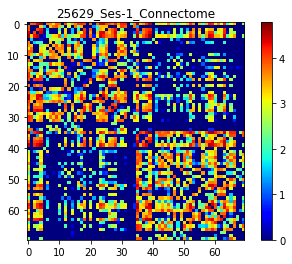

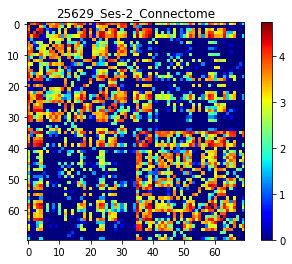

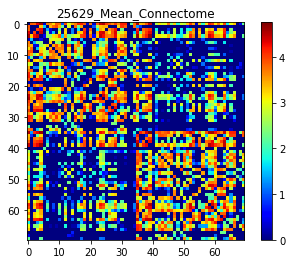

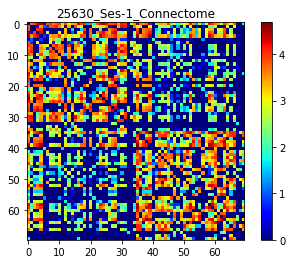

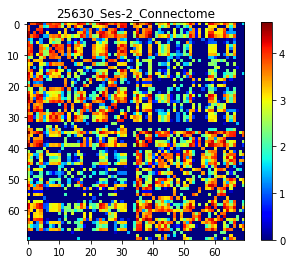

...

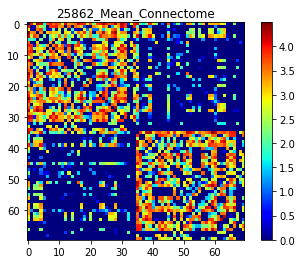

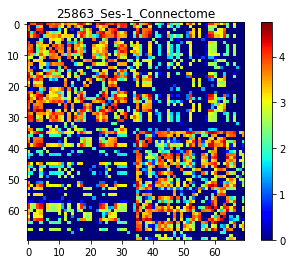

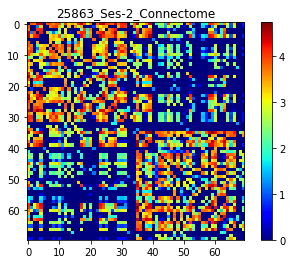

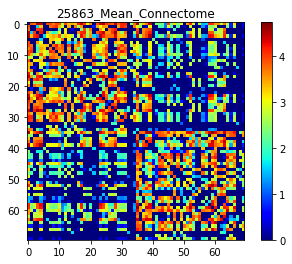

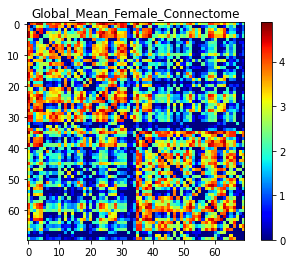

In [32]:
# Criteria 2 (25 points) compute and visualize class conditional connectomes (e.g., male and female subpopulations)
 
# Female and Male Subpopulations (Sex = 0 and 1 respectively)
# Visualized the individual Male and Female connectomes, the mean of each, and
# the global mean of each sex.

# Munging
bool_g1_sex_0 = [x==0 for x in sex_g1]
bool_g1_sex_1 = [y==1 for y in sex_g1]
bool_g2_sex_0 = [x==0 for x in sex_g2]
bool_g2_sex_1 = [y==1 for y in sex_g2]

g1_0 = [g1[i] for i in range(len(g1)) if bool_g1_sex_0[i]]
g1_1 = [g1[i] for i in range(len(g1)) if bool_g1_sex_1[i]]
g2_0 = [g2[i] for i in range(len(g2)) if bool_g2_sex_0[i]]
g2_1 = [g2[i] for i in range(len(g2)) if bool_g2_sex_1[i]]

k_g1_0 = [k_id_g1[i] for i in range(len(k_id_g1)) if bool_g1_sex_0[i]]
k_g1_1 = [k_id_g1[i] for i in range(len(k_id_g1)) if bool_g1_sex_1[i]]
k_g2_0 = [k_id_g2[i] for i in range(len(k_id_g2)) if bool_g2_sex_0[i]]
k_g2_1 = [k_id_g2[i] for i in range(len(k_id_g2)) if bool_g2_sex_1[i]]


print("SES-1 AND SES-2 FEMALE (SEX = 0) SUBPOPULATION")
print("==============================================")

# Printing Ses-1 and Ses-2
matrix_global_0 = np.zeros((70,70))
for i in range(len(g1_0)):
  
  #Ses-1 Raw
  matrix_g1_0 = nx.to_numpy_matrix(g1_0[i], nodelist=sorted(g1_0[i].nodes()))
  plt.imshow(np.log10(matrix_g1_0+1),cmap='jet')
  plt.colorbar()
  plt.title('{}_Ses-1_Connectome'.format(k_g1_0[i]))
  plt.show()
  
  #Ses-2 Raw
  matrix_g2_0 = nx.to_numpy_matrix(g2_0[i], nodelist=sorted(g2_0[i].nodes()))
  plt.imshow(np.log10(matrix_g2_0+1),cmap='jet')
  plt.colorbar()
  plt.title('{}_Ses-2_Connectome'.format(k_g2_0[i]))
  plt.show()

  #Mean of Ses-1 and Ses-2
  matrix_avg_female = np.add(matrix_g1_0, matrix_g2_0)
  matrix_avg_female = np.true_divide(matrix_avg_female, 2)
  plt.imshow(np.log10(matrix_avg_female+1),cmap='jet')
  plt.colorbar()
  plt.title('{}_Mean_Connectome'.format(k_g1_0[i]))
  plt.show()

  # Global Mean of Female
  matrix_global_0 = np.add(matrix_global_0, matrix_g1_0)
  matrix_global_0 = np.add(matrix_global_0, matrix_g2_0)

matrix_global_0 = np.true_divide(matrix_global_0, len(g1_0))
plt.imshow(np.log10(matrix_global_0+1),cmap='jet')
plt.colorbar()
plt.title('Global_Mean_Female_Connectome')
plt.show()

SES-1 AND SES-2 MALE (SEX = 1) SUBPOPULATION


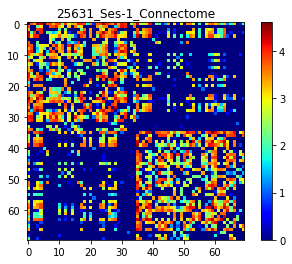

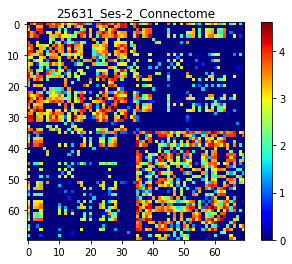

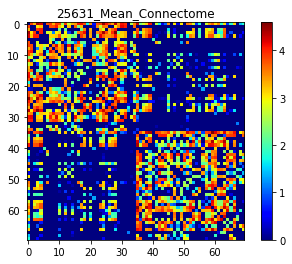

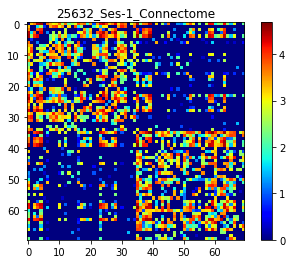

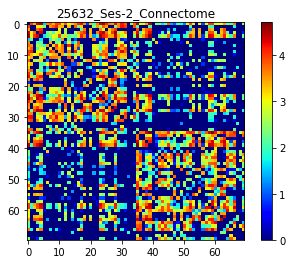

...

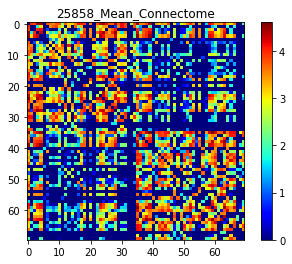

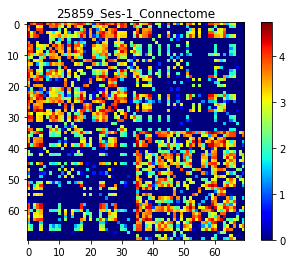

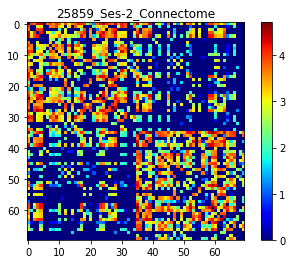

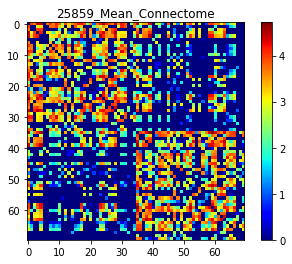

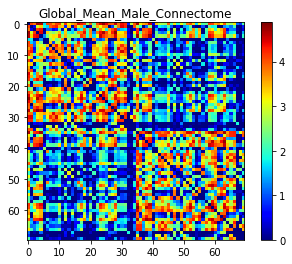

In [37]:
print("SES-1 AND SES-2 MALE (SEX = 1) SUBPOPULATION")
print("============================================")

# Printing Ses-1 and Ses-2
matrix_global_1 = np.zeros((70,70))
for i in range(len(g1_1)):
  
  #Ses-1 Raw
  matrix_g1_1 = nx.to_numpy_matrix(g1_1[i], nodelist=sorted(g1_1[i].nodes()))
  plt.imshow(np.log10(matrix_g1_1+1),cmap='jet')
  plt.colorbar()
  plt.title('{}_Ses-1_Connectome'.format(k_g1_1[i]))
  plt.show()
  
  #Ses-2 Raw
  matrix_g2_1 = nx.to_numpy_matrix(g2_1[i], nodelist=sorted(g2_1[i].nodes()))
  plt.imshow(np.log10(matrix_g2_1+1),cmap='jet')
  plt.colorbar()
  plt.title('{}_Ses-2_Connectome'.format(k_g2_1[i]))
  plt.show()

  #Mean of Ses-1 and Ses-2
  matrix_avg_male = np.add(matrix_g1_1, matrix_g2_1)
  matrix_avg_male = np.true_divide(matrix_avg_male, 2)
  plt.imshow(np.log10(matrix_avg_male+1),cmap='jet')
  plt.colorbar()
  plt.title('{}_Mean_Connectome'.format(k_g1_1[i]))
  plt.show()

  # Global Mean of Male
  matrix_global_1 = np.add(matrix_global_1, matrix_g1_1)
  matrix_global_1 = np.add(matrix_global_1, matrix_g2_1)

matrix_global_1 = np.true_divide(matrix_global_1, len(g1_1))
plt.imshow(np.log10(matrix_global_1+1),cmap='jet')
plt.colorbar()
plt.title('Global_Mean_Male_Connectome')
plt.show()

In [40]:
# Criteria 3 (30 points) compute 5 different covariates related to graphs
def path_lengths(graph):
    """Compute array of all shortest path lengths for graph.
    """
    
    length = nx.all_pairs_shortest_path_length(graph)
    paths = []
    seen = set()
    for src,targets in length.items():
        seen.add(src)
        neigh = set(targets.keys()) - seen
        paths.extend(targets[targ] for targ in neigh)
    
    
    return np.array(paths)
def mean_pathlength(graph):
    """Compute mean path length for graph.
    """
    
    lengths = nx.all_pairs_shortest_path_length(graph)
    nodal_means = [np.mean(list(lengths[src].values())) for src in sorted(lengths)]
    return np.average(np.array(nodal_means))

def global_efficiency(graph):
    """Computes global efficiency of the network."""
    
    return np.average(1.0/path_lengths(graph))

def local_efficiency(graph):
    """Computes average local efficiency for graph
    """

    nodepaths=[]
    length=nx.all_pairs_shortest_path_length(graph)
    for n in graph.nodes():
        nneighb= nx.neighbors(graph,n)
        
        paths=[]
        for src,targets in length.items():
            for targ,val in targets.items():
                val=float(val)
                if src==targ:
                    continue
                if src in nneighb and targ in nneighb:
                    
                    paths.append(1/val)
        
        p=np.array(paths)
        psize=np.size(p)
        if (psize==0):
            p=np.array(0)
            
        nodepaths.append(p.mean())
    
    val = np.array(nodepaths)

    return val.mean()

def clustering(graph):
  """Returns average clustering coefficient"""

  cluster = np.array(list(nx.clustering(graph).values()))
  
  return cluster.mean()

print("===============")
print("Mean Pathlength")
print("===============")
print("Females:")
print(mean_pathlength(nx.from_numpy_matrix(matrix_global_0)))
print("\nMales:")
print(mean_pathlength(nx.from_numpy_matrix(matrix_global_1)))

print("\n=================")
print("(Mean) Global Efficiency")
print("=================")
print("Females:")
print(global_efficiency(nx.from_numpy_matrix(matrix_global_0)))
print("\nMales:")
print(global_efficiency(nx.from_numpy_matrix(matrix_global_1)))

print("\n=================")
print("(Mean) Local Efficiency")
print("=================")
print("Females:")
print(local_efficiency(nx.from_numpy_matrix(matrix_global_0)))
print("\nMales:")
print(local_efficiency(nx.from_numpy_matrix(matrix_global_1)))


print("\n=================")
print("(Mean) Clustering Coefficient")
print("=================")
print("Females:")
print(clustering(nx.from_numpy_matrix(matrix_global_0)))
print("\nMales:")
print(clustering(nx.from_numpy_matrix(matrix_global_1)))


print("\n=================")
print("Largest Clique Size")
print("=================")
print("Females:")
print(nx.graph_clique_number(nx.from_numpy_matrix(matrix_global_0)))
print("\nMales:")
print(nx.graph_clique_number(nx.from_numpy_matrix(matrix_global_1)))

Mean Pathlength
Females:
1.10734693877551

Males:
1.1216326530612246

(Mean) Global Efficiency
Females:
0.9383022774327122

Males:
0.931055900621118

(Mean) Local Efficiency
Females:
0.9570659860446944

Males:
0.9560752500824522

(Mean) Clustering Coefficient
Females:
0.9141319720893887

Males:
0.9121505001649052

Largest Clique Size
Females:
47

Males:
49


In [0]:
# Criteria 4 (20 points) interpret meaning of covariates, with some hypothesis connecting to neuroscience (words and/or code)

### Criteria 4 (20 points) interpret meaning of covariates, with some hypothesis connecting to neuroscience (words and/or code)
- **Mean Pathlength**
  - The mean or characteristic pathlength, for an undirected graph, is the average of all of the shortest path lengths between two nodes in the graph. This gives more detail on the overall structure of the brain and the propensity of clustering. If the mean pathlength is about 1, then the nodes are very well connected and a lot of hubs are present in the brain. With the Desikan Atlas, there are 70 total ROIs, so the connectivity between them should be fairly high considering 70 total regions is not that large compared to the number of disparite regions in the brain that could be isolated. So, with each ROI being a comparatively large amount of brain space (compared to 200 or more regions of interest for example), the connectivity should be high and about the same for males and females, which is the case. I hypothesize that the brain morphology differences between men and women should be not be very noticable given less than 100 ROIs, since these large regions overall are constructed the same and are highly connected. The differences lie moreso in the smaller details. For example, I also hypothesize that the mean/characteristic pathlength differs between males and females in specific regions, such as the hippocampus or the visual cortex.

- **Global Efficiency**
  - The global efficiency, for an undirected graph, ranges from 0 to 1 and is a measure of the sparsity of a graph. If global efficiency is closer to 0, the graph contains many nodes that are not connected to other nodes and is thus sparse. If global efficiency is closer to 1, then there are many hubs and immediate connections between nodes. If every node is directly connected to every other node through a path, then the global efficiency is 1. In another sense, efficiency quantifies how quickly a particle could travel from one node to another in the graph. This is another measure of connectivity and for the dataset I again hypothesize that this should be fairly high and not very different for males and females for the same reasons mentioned earlier. This is shown to be true. However, I assert that much like the characteristic path length, the global efficiency should moreso differ in smaller regions for which we have evidence supporting a phenotypic-dependent circuitry. Global measures for the entire graph of the human brain, I assert in general should be the same for males and females.

- **Local Efficiency**
  - The local efficiency, for an undirected graph, is the average efficiency of all subgraphs in the graph that consists of all immediate neighbors of a node but not the node itself. In the literature, there is some evidence of efficiency, global and local, being linked to sex like [here](https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0118857). In this data set, I continue to assert the results are too inconclusive. Further, all of these factors likely differ at some regions in the brains of males and females. Also, trauma certainly changes the circuitry and thus all of the covariates for a human brain. How female and male brains respond to trauma may be different, like what this [source](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5737777/) claims.

- **(Mean) Clustering Coefficient**
  - The (Mean) Clustering Coefficient, for an undirected and weighted graph, is the normalized geometric mean of the edge weights. This is an interesting statistic, it quantifies the clustering of nodes and the overall strength of node to node connection. I hypothesize this statistic is much more susceptible to individual genetic and epigenetic factors, such as trauma, plasticity, and development. Since this will have such a higher variation individual to individual, the overall average should be fairly inconclusive. However, the overall clustering coefficients for the data are much closer than I thought they would be, since I believe this statistic to be particularly dependent on individual genetic makeup and history.

- **Largest Clique Size**
  - The Largest Clique size is the number of nodes in the largest clique, which is a subset of nodes where the vertices are directly connected or "adjacent" to one another. In both males and females, the clique size is over half the size of the entire set of nodes that make up the graph. This indicates a highly connected brain region and supports the claims of some that a male brain has a higher degree of connectivity than a female human brain, [link](https://www.mit.edu/~6.s085/papers/sex-differences.pdf). With this data set I again feel this is too presumptive. Also, I assert that the proported increased connectivity within the male human brain is a result of poor random sampling and too small of a sample size as opposed to a codified result. The human brain is more complex than we even know at the moment, and until we develop pioneering ways to go through large scale, higher resolution data, I assert we cannot make this claim. There are too many confounding variables besides sex in the human brain.


In [0]:
#Combine features, separate training and test data

X = []
X_other = []
for i in range(len(g1)):
    
    #First Session
    featvec = []
    
    dc = nx.algorithms.degree_centrality(g1[i])
    dcmean = np.mean(np.asarray(list(dc.values())))
    featvec.append(dcmean)

    dcall = np.asarray(list(dc.values()))
    for ii in dcall:
        featvec.append(ii)   
    
    matrix = nx.to_numpy_matrix(g1[i], nodelist=sorted(g1[i].nodes())) #this is how you go to a matrix
    logmatrix = np.log10(np.sum(matrix,0) + 1)
    logmatrix = np.ravel(logmatrix)
        
    for ii in logmatrix:
        featvec.append(ii)

    xsum = np.asarray(np.sum(matrix))
    featvec.append(xsum)

    #Second Session
    X.append(featvec)

    featvec = []
    
    dc = nx.algorithms.degree_centrality(g2[i])
    dcmean = np.mean(np.asarray(list(dc.values())))
    featvec.append(dcmean)

    dcall = np.asarray(list(dc.values()))
    for ii in dcall:
        featvec.append(ii)   
    
    matrix = nx.to_numpy_matrix(g2[i], nodelist=sorted(g2[i].nodes())) #this is how you go to a matrix
    logmatrix = np.log10(np.sum(matrix,0) + 1)
    logmatrix = np.ravel(logmatrix)
        
    for ii in logmatrix:
        featvec.append(ii)

    xsum = np.asarray(np.sum(matrix))
    featvec.append(xsum)
    X_other.append(featvec)
    

In [22]:
# Criteria 5 (30 points) build classifier and obtain classification score at 70\% or higher
import random

# Doubled the data size: used session 1 and session 2
X_train = X
Y_train = sex_g1

X_test = X_other
Y_test = sex_g2

from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LogisticRegression
from sklearn import svm

accuracy = []
for ii in range(10): #performance will change over time
    clf = RandomForestClassifier(n_estimators=1500) #Increased n_estimators
    clf.fit(X_train, Y_train)
    acc = (clf.predict(X_test) == Y_test)
    accval = (float(np.sum(acc))/float(len(Y_test)))
    accuracy.append(accval)
    print('Accuracy:',accval)

print('Overall Accuracy:',str(np.mean(accuracy)))

Accuracy: 0.8061674008810573
Accuracy: 0.8061674008810573
Accuracy: 0.8237885462555066
Accuracy: 0.8149779735682819
Accuracy: 0.8237885462555066
Accuracy: 0.8237885462555066
Accuracy: 0.8193832599118943
Accuracy: 0.8237885462555066
Accuracy: 0.801762114537445
Accuracy: 0.8149779735682819
Overall Accuracy: 0.8158590308370044
